# EE0005 Mini Project 
## Dataset : Cardiovascular Disease Dataset
## Team 2
### Team members :
### Chew Tau Khoon , Goh Qian Wei, Jovan Hermawan, Pray Apostel
# Goal / Problem Set : To inform people the risk of having cardiovascular disease by using their current information

# Importing The Basic Libraries and Data

In [1]:
# Basic Libraries
import numpy as np
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt # we only need pyplot
sb.set() # set the default Seaborn style for graphics

In [2]:
data = pd.read_csv("cardio_train.csv", sep=";")
data

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
69995,99993,19240,2,168,76.0,120,80,1,1,1,0,1,0
69996,99995,22601,1,158,126.0,140,90,2,2,0,0,1,1
69997,99996,19066,2,183,105.0,180,90,3,1,0,1,0,1
69998,99998,22431,1,163,72.0,135,80,1,2,0,0,0,1


# Data Visualization using Plotly

### Please install the required libraries first

In [3]:
import pandas as pd
import numpy as np
import chart_studio.plotly as py
import cufflinks as cf
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import zscore
%matplotlib inline

# Make Plotly work in your Jupyter Notebook
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)
# Use Plotly locally
cf.go_offline()

In [4]:
df = pd.read_csv("cardio_train.csv", sep = ';')
# Categorizing the data
df['cardio'] = df['cardio'].astype("category")
df['gluc'] = df['gluc'].astype("category")
df['cholesterol'] = df['cholesterol'].astype("category")
df['smoke'] = df['smoke'].astype("category")
df['alco'] = df['alco'].astype("category")
df['active'] = df['active'].astype("category")

# Add BMI to the data
df["BMI"] = pd.DataFrame(df["weight"]/(df["height"]/100)**2)
col_num =["age", "weight", "height", "ap_hi", "ap_lo", "BMI"]
col_cat = ['gender', 'cholesterol', 'gluc', 'smoke', 'alco', 'active']


## Scatter plot of weight (x) and height (y)

In [52]:
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df.weight[:1000], y=df.height[:1000], #only 1000 for demonstration purposes only to avoid lag
    mode='markers',
    marker_color=df.weight,
    marker=dict(showscale=True)
))
fig.update_traces(marker_line_width=2, marker_size=10)

## Histogram of each categorical variable against Cardiovascular state (1 = infected)

In [8]:
import plotly.express as px
for i in df:
    if i != 'id' and i != 'cardio' and i not in col_num:
        fig = px.histogram(df, x=i, color="cardio")
        fig.show()

## Boxplot of each numeric variable against Cardiovascular state (1 = Have Disease)

In [5]:
for i in range(len(col_num)):
    
    fig = px.box(df, x=df[col_num[i]], color="cardio",
             notched=True, # used notched shape
             title=col_num[i],
                )
    fig.show()

## Outliers Removal

In [6]:
df_num = pd.DataFrame(df[col_num + ['cardio']])
z_scores = zscore(df_num)
abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
df_num2 = df_num[filtered_entries]
df_num2

,age,weight,height,ap_hi,ap_lo,BMI,cardio
0,18393,62.0,168,110,80,21.967120,0
1,20228,85.0,156,140,90,34.927679,1
2,18857,64.0,165,130,70,23.507805,1
3,17623,82.0,169,150,100,28.710479,1
4,17474,56.0,156,100,60,23.011177,0
...,...,...,...,...,...,...,...
69994,21074,80.0,165,150,80,29.384757,1
69995,19240,76.0,168,120,80,26.927438,0
69997,19066,105.0,183,180,90,31.353579,1
69998,22431,72.0,163,135,80,27.099251,1


## Boxplot of each numeric variable against Cardiovascular state after outliers removal (1 = infected)

In [7]:
for i in range(len(col_num)):
    
    fig = px.box(df_num2, x=df_num2[col_num[i]], color="cardio",
             notched=True, # used notched shape
             title=col_num[i],
                )
    fig.show()

In [10]:
df_ap = pd.DataFrame(df[['ap_hi', 'ap_lo']])

In [11]:
import plotly.express as px
for i in range(len(col_cat)):
    fig = px.sunburst(df, path=[col_cat[i], 'cardio'], title=col_cat[i])
    fig.show()

# Data Preparation

In [12]:
import plotly.offline as py
import plotly.figure_factory as ff
import plotly.graph_objs as go
from plotly import tools
data.shape

(70000, 13)

In [13]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           70000 non-null  int64  
 1   age          70000 non-null  int64  
 2   gender       70000 non-null  int64  
 3   height       70000 non-null  int64  
 4   weight       70000 non-null  float64
 5   ap_hi        70000 non-null  int64  
 6   ap_lo        70000 non-null  int64  
 7   cholesterol  70000 non-null  int64  
 8   gluc         70000 non-null  int64  
 9   smoke        70000 non-null  int64  
 10  alco         70000 non-null  int64  
 11  active       70000 non-null  int64  
 12  cardio       70000 non-null  int64  
dtypes: float64(1), int64(12)
memory usage: 6.9 MB


### All datas are in integer or float already, no categorical data needed to be converted to be integers

In [14]:
data.describe()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,49972.419900,19468.865814,1.349571,164.359229,74.205690,128.817286,96.630414,1.366871,1.226457,0.088129,0.053771,0.803729,0.499700
std,28851.302323,2467.251667,0.476838,8.210126,14.395757,154.011419,188.472530,0.680250,0.572270,0.283484,0.225568,0.397179,0.500003
min,0.000000,10798.000000,1.000000,55.000000,10.000000,-150.000000,-70.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,25006.750000,17664.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
50%,50001.500000,19703.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,74889.250000,21327.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.000000,0.000000,1.000000,1.000000
max,99999.000000,23713.000000,2.000000,250.000000,200.000000,16020.000000,11000.000000,3.000000,3.000000,1.000000,1.000000,1.000000,1.000000


In [15]:
data.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [16]:
dataDF = pd.DataFrame(data)

### Removing the outliers from the data

In [17]:
from scipy import stats
z_scores = stats.zscore(dataDF)
abs_z_scores = np.abs(z_scores)
filtered_entries = (abs_z_scores < 3).all(axis=1)
dataDF = dataDF[filtered_entries]

### Combining height and weight into bmi

In [18]:
X = pd.DataFrame(dataDF[["age","height","weight","ap_hi","cholesterol", "gluc","smoke","alco","gender"]])
y = pd.DataFrame(dataDF["cardio"])
X['bmi']=pd.DataFrame(X['weight']/(X['height']/100)**2)
X= pd.DataFrame(X[["age","bmi","ap_hi","cholesterol", "gluc","smoke","alco","gender"]])

### Data Standardisation / Scaling

In [19]:
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
sc_X = sc_X.fit_transform(X)
X = pd.DataFrame(data=sc_X, columns=["age","bmi","ap_hi","cholesterol", "gluc","smoke","alco","gender"])
X

,age,bmi,ap_hi,cholesterol,gluc,smoke,alco,gender
0,-0.423095,-1.077424,-0.881197,-0.468621,-0.28668,0.0,0.0,1.548862
1,0.319570,1.597090,0.808684,3.000740,-0.28668,0.0,0.0,-0.645635
2,-0.235304,-0.759491,0.245390,3.000740,-0.28668,0.0,0.0,-0.645635
3,-0.734732,0.314122,1.371978,-0.468621,-0.28668,0.0,0.0,1.548862
4,-0.795035,-0.861974,-1.444491,-0.468621,-0.28668,0.0,0.0,-0.645635
...,...,...,...,...,...,...,...,...
55694,-0.261611,-1.152335,2.498565,-0.468621,-0.28668,0.0,0.0,-0.645635
55695,0.105472,-0.727788,0.245390,-0.468621,-0.28668,0.0,0.0,-0.645635
55696,0.661966,0.453264,1.371978,-0.468621,-0.28668,0.0,0.0,-0.645635
55697,1.211174,-0.018368,0.527037,-0.468621,3.48821,0.0,0.0,-0.645635


In [20]:
X= pd.DataFrame(X[["age","bmi","ap_hi","cholesterol", "gluc","smoke","alco","gender"]])

In [21]:
# Import train_test_split from sklearn
from sklearn.model_selection import train_test_split

### Splitting the data set with test size of 0.25

In [22]:
# Split the Dataset into Train and Test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25)

# Check the sample sizes
print("Train Set :", y_train.shape, X_train.shape)
print("Test Set  :", y_test.shape, X_test.shape)

Train Set : (41774, 1) (41774, 8)
Test Set  : (13925, 1) (13925, 8)


# Support Vector Machine

In [23]:
from sklearn import svm
from sklearn import metrics
from sklearn.metrics import confusion_matrix, f1_score, precision_score, recall_score

In [24]:
clf = svm.SVC()
clf.fit(X_train, y_train.values.ravel())

SVC()

In [25]:
y_train_pred = clf.predict(X_train)
print("Accuracy:",metrics.accuracy_score(y_train, y_train_pred)) 
print("Precision:",metrics.precision_score(y_train, y_train_pred)) 
print("Recall:",metrics.recall_score(y_train, y_train_pred))

Accuracy: 0.7323215397136975
Precision: 0.7720468890892697
Recall: 0.6347551030494736


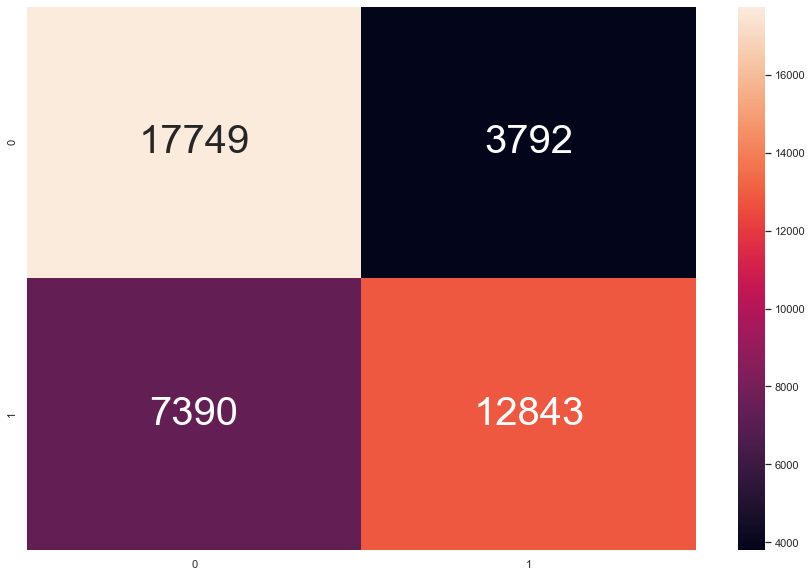

In [26]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_train, y_train_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})


In [27]:
y_test_pred = clf.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred)) 
print("Precision:",metrics.precision_score(y_test, y_test_pred)) 
print("Recall:",metrics.recall_score(y_test, y_test_pred))

Accuracy: 0.7294793536804309
Precision: 0.7696034451821281
Recall: 0.6333431777909038


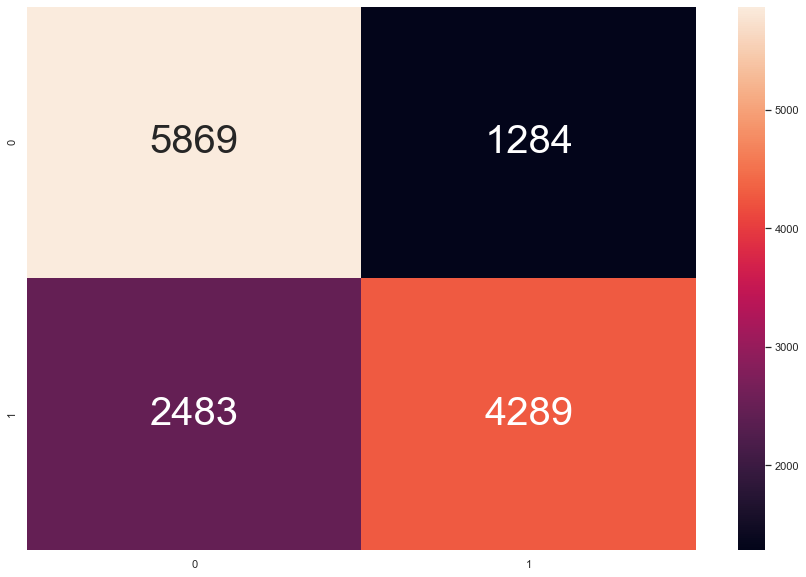

In [28]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})


In [29]:
# print out metric scores
print("Support Vector Machine\n")
# Precision: TP/(TP+FP)
print("Precision:", metrics.precision_score(y_test, y_test_pred))
# Recall: TP/(TP+FN)
print("Recall:", metrics.recall_score(y_test, y_test_pred))
# F1 Score: 2*recall*precision/(recall+precision) ie. balance between precision and recall
print("F1 Score:", metrics.f1_score(y_test, y_test_pred))

svmacc = metrics.accuracy_score(y_test, y_test_pred)
svmprecision = metrics.precision_score(y_test, y_test_pred)
svmrecall = metrics.recall_score(y_test, y_test_pred)
svmf1 = metrics.f1_score(y_test, y_test_pred)


Support Vector Machine

Precision: 0.7696034451821281
Recall: 0.6333431777909038
F1 Score: 0.69485621709194


# Logistic Regression


In [30]:
from sklearn.linear_model import LogisticRegression
logreg = LogisticRegression(max_iter=2500,C=1e40, solver='liblinear')
logreg.fit(X_train, y_train.values.ravel())
y_train_pred = logreg.predict(X_train)
print("Accuracy:",metrics.accuracy_score(y_train, y_train_pred)) 
print("Precision:",metrics.precision_score(y_train, y_train_pred)) 
print("Recall:",metrics.recall_score(y_train, y_train_pred))

Accuracy: 0.7234643558194092
Precision: 0.7511718071870841
Recall: 0.641575643750309


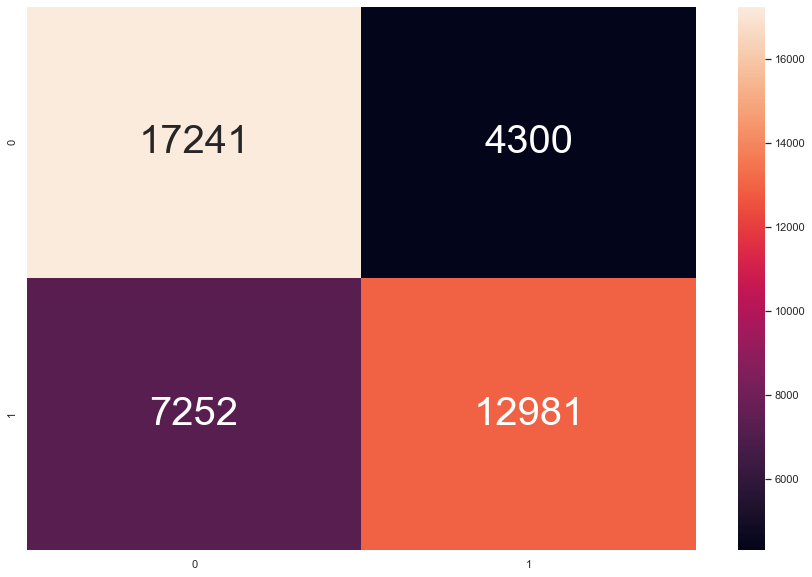

In [31]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_train, y_train_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})

In [32]:
y_test_pred = logreg.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred)) 
print("Precision:",metrics.precision_score(y_test, y_test_pred)) 
print("Recall:",metrics.recall_score(y_test, y_test_pred))

Accuracy: 0.7227289048473967
Precision: 0.7518601834227375
Recall: 0.6416125221500295


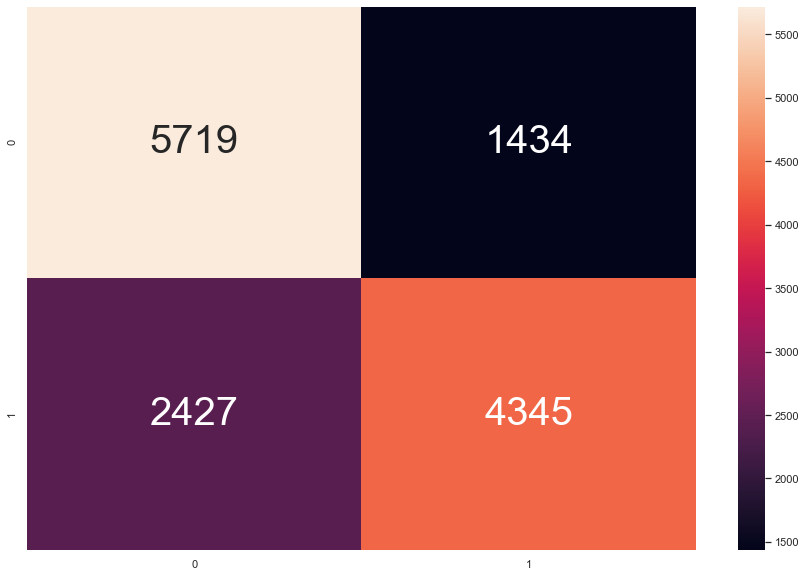

In [33]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})


In [34]:
# print out metric scores
print("Logistic Regression\n")
# Precision: TP/(TP+FP)
print("Precision:", metrics.precision_score(y_test, y_test_pred))
# Recall: TP/(TP+FN)
print("Recall:", metrics.recall_score(y_test, y_test_pred))
# F1 Score: 2*recall*precision/(recall+precision) ie. balance between precision and recall
print("F1 Score:", metrics.f1_score(y_test, y_test_pred))

logisticacc = metrics.accuracy_score(y_test, y_test_pred)
logisticprecision = metrics.precision_score(y_test, y_test_pred)
logisticf1 = metrics.f1_score(y_test, y_test_pred)
logisticrecall = metrics.recall_score(y_test, y_test_pred)

Logistic Regression

Precision: 0.7518601834227375
Recall: 0.6416125221500295
F1 Score: 0.6923751095530237


# Random Forest Algorithm

In [35]:
from sklearn.ensemble import RandomForestClassifier

In [36]:
forest = RandomForestClassifier(n_estimators = 300)
forest.fit(X_train, y_train.values.ravel())
y_train_pred = forest.predict(X_train)
print("Accuracy:",metrics.accuracy_score(y_train, y_train_pred)) 
print("Precision:",metrics.precision_score(y_train, y_train_pred)) 
print("Recall:",metrics.recall_score(y_train, y_train_pred))

Accuracy: 0.999497294968162
Precision: 0.9997033227848101
Recall: 0.999258636880344


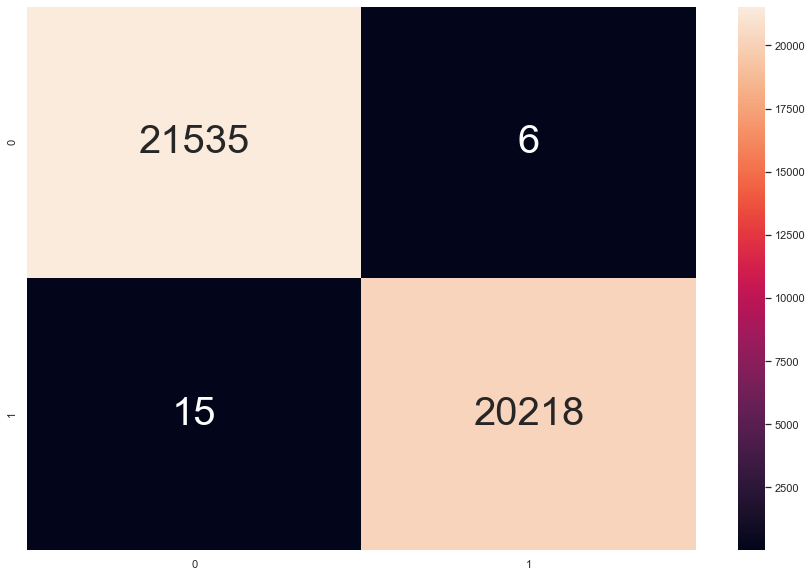

In [37]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_train, y_train_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})

In [38]:
y_test_pred = forest.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred)) 
print("Precision:",metrics.precision_score(y_test, y_test_pred)) 
print("Recall:",metrics.recall_score(y_test, y_test_pred))

Accuracy: 0.6927827648114901
Precision: 0.6888821569221448
Recall: 0.6715888954518606


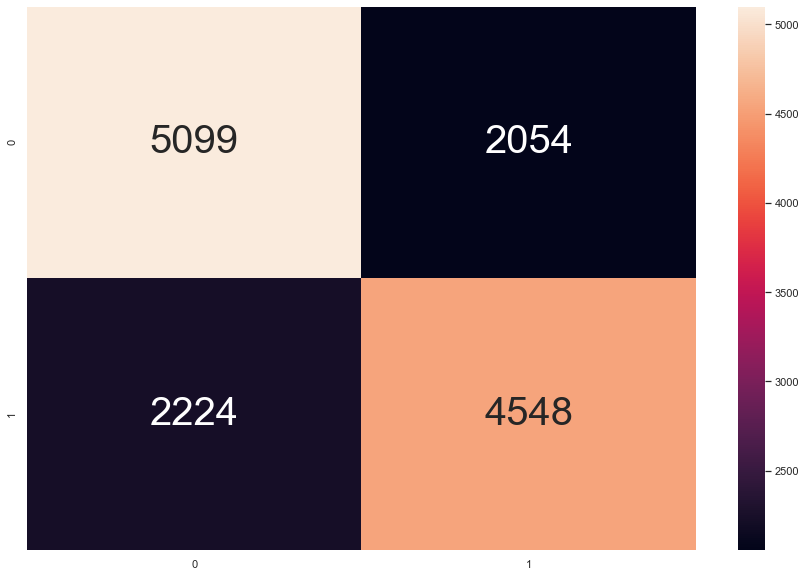

In [39]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})

In [40]:
# print out metric scores
print("Random Forest Algorithm\n")
# Precision: TP/(TP+FP)
print("Precision:", metrics.precision_score(y_test, y_test_pred))
# Recall: TP/(TP+FN)
print("Recall:", metrics.recall_score(y_test, y_test_pred))
# F1 Score: 2*recall*precision/(recall+precision) ie. balance between precision and recall
print("F1 Score:", metrics.f1_score(y_test, y_test_pred))

forestacc = metrics.accuracy_score(y_test, y_test_pred)
forestprecision = metrics.precision_score(y_test, y_test_pred)
forestf1 = metrics.f1_score(y_test, y_test_pred)
forestrecall = metrics.recall_score(y_test, y_test_pred)

Random Forest Algorithm

Precision: 0.6888821569221448
Recall: 0.6715888954518606
F1 Score: 0.6801256168685509


# Gaussian Naive Bayes

In [41]:
from sklearn.naive_bayes import GaussianNB
gnb = GaussianNB()
gnb.fit(X_train, y_train.values.ravel())
y_train_pred = gnb.predict(X_train)
print("Accuracy:",metrics.accuracy_score(y_train, y_train_pred)) 
print("Precision:",metrics.precision_score(y_train, y_train_pred)) 
print("Recall:",metrics.recall_score(y_train, y_train_pred))

Accuracy: 0.6826255565662852
Precision: 0.7306090061495735
Recall: 0.5460880739386151


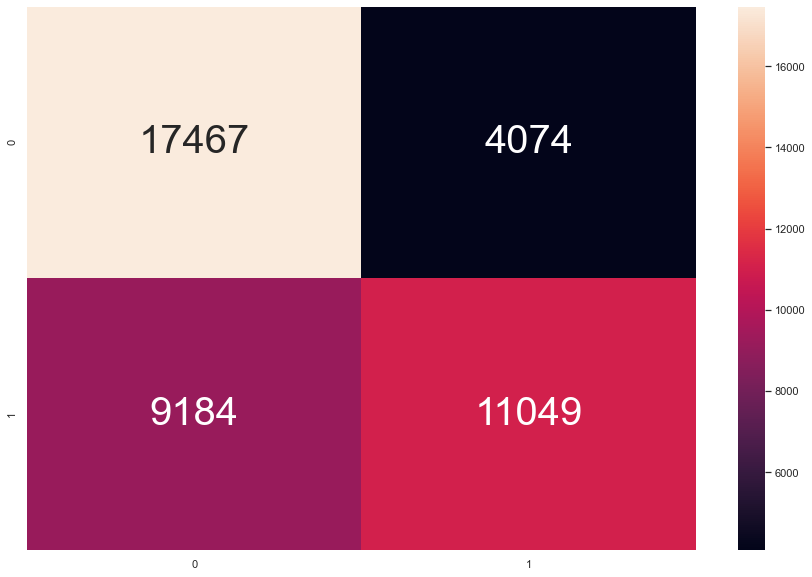

In [42]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_train, y_train_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})

In [43]:
y_test_pred = gnb.predict(X_test)
print("Accuracy:",metrics.accuracy_score(y_test, y_test_pred)) 
print("Precision:",metrics.precision_score(y_test, y_test_pred)) 
print("Recall:",metrics.recall_score(y_test, y_test_pred))

Accuracy: 0.6802872531418312
Precision: 0.7298850574712644
Recall: 0.543857058476078


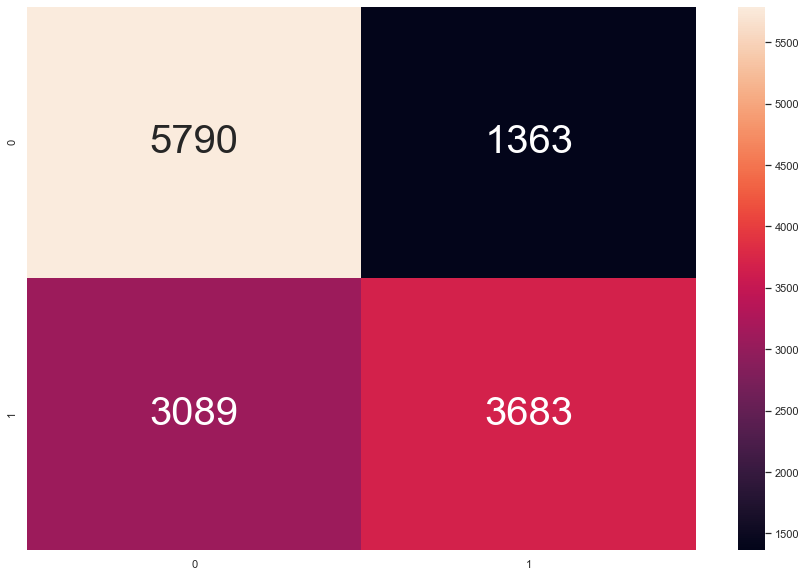

In [44]:
plt.figure(figsize=(15,10))
sb.heatmap(confusion_matrix(y_test, y_test_pred), 
           annot = True, fmt=".0f", annot_kws={"size": 40})

In [45]:
# print out metric scores
print("Gaussian Naive Bayes\n")
# Precision: TP/(TP+FP)
print("Precision:", metrics.precision_score(y_test, y_test_pred))
# Recall: TP/(TP+FN)
print("Recall:", metrics.recall_score(y_test, y_test_pred))
# F1 Score: 2*recall*precision/(recall+precision) ie. balance between precision and recall
print("F1 Score:", metrics.f1_score(y_test, y_test_pred))

bayesacc = metrics.accuracy_score(y_test, y_test_pred)
bayesprecision = metrics.precision_score(y_test, y_test_pred)
bayesf1 = metrics.f1_score(y_test, y_test_pred)
bayesrecall = metrics.recall_score(y_test, y_test_pred)


Gaussian Naive Bayes

Precision: 0.7298850574712644
Recall: 0.543857058476078
F1 Score: 0.6232865121001863


# Comparison

### Recall

In [46]:
print("Support Vector Machine Recall: " ,svmrecall)
print("Logistic Regression Recall: " ,logisticrecall)
print("Random Forest Algorithm Recall: " ,forestrecall)
print("Gaussian Naive Bayes Recall: " ,bayesrecall)

Support Vector Machine Recall:  0.6333431777909038
Logistic Regression Recall:  0.6416125221500295
Random Forest Algorithm Recall:  0.6715888954518606
Gaussian Naive Bayes Recall:  0.543857058476078


### F1

In [47]:
print("Support Vector Machine F1: " ,svmf1)
print("Logistic Regression F1: " ,logisticf1)
print("Random Forest Algorithm F1: " ,forestf1)
print("Gaussian Naive Bayes F1: " ,bayesf1)


Support Vector Machine F1:  0.69485621709194
Logistic Regression F1:  0.6923751095530237
Random Forest Algorithm F1:  0.6801256168685509
Gaussian Naive Bayes F1:  0.6232865121001863


### Accuracy

In [48]:
print("Support Vector Machine Accuracy: " ,svmacc)
print("Logistic Regression Accuracy: " ,logisticacc)
print("Random Forest Algorithm Accuracy: " ,forestacc)
print("Gaussian Naive Bayes Accuracy: " ,bayesacc)

Support Vector Machine Accuracy:  0.7294793536804309
Logistic Regression Accuracy:  0.7227289048473967
Random Forest Algorithm Accuracy:  0.6927827648114901
Gaussian Naive Bayes Accuracy:  0.6802872531418312


### Precision

In [49]:
print("Support Vector Machine Precision: " ,svmprecision)
print("Logistic Regression Precision: " ,logisticprecision)
print("Random Forest Algorithm Precision: " ,forestprecision)
print("Gaussian Naive Bayes Precision: " ,bayesprecision)

Support Vector Machine Precision:  0.7696034451821281
Logistic Regression Precision:  0.7518601834227375
Random Forest Algorithm Precision:  0.6888821569221448
Gaussian Naive Bayes Precision:  0.7298850574712644


# We pick Random Forest Algorithm for the most suitable architecture in our case, why ?

## Random Forest Algorithm constantly gives the highest recall out of all the models tested, but why do we focus on recall though?

## Since our goal is to inform people whether or not they are at risk of Cardiovascular disease, it will be way better for us to avoid false negative as much as possible. 

## We focus to avoid false negatives because telling someone that is at risk of the disease that they are not at risk of the disease might cause fatal problems.

## Since Recall is TP/(TP+FN), hence the higher the recall, the higher the ratio between correctly predicted positives and wrongly predicted negatives, which is what we want (to have less false negatives)

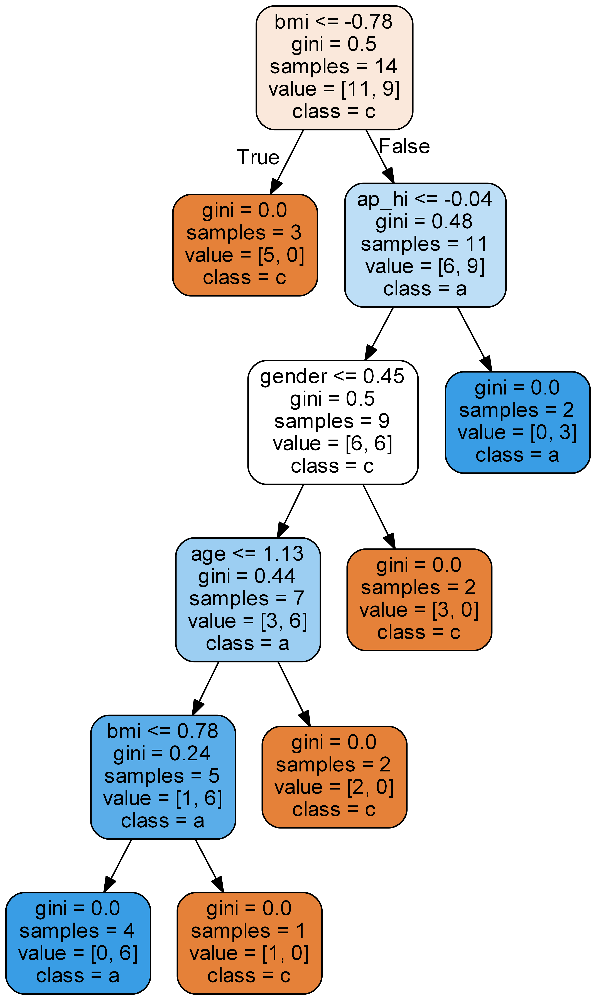

In [50]:
from sklearn.datasets import load_iris

# Model (can also use single decision tree)
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=10)

# Train
model.fit(X_train[:20], y_train[:20].values.ravel())#We use only 20 data for visualization purposeonly
# Extract single tree
estimator = model.estimators_[5]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = ["age","bmi","ap_hi","cholesterol", "gluc","smoke","alco","gender"],
                class_names = "cardio",
                rounded = True, proportion = False, 
                precision = 2, filled = True)

# Convert to png using system command (requires Graphviz)
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'tree.png', '-Gdpi=600'], shell=True)

# Display in jupyter notebook
from IPython.display import Image
Image(filename = 'tree.png')

## We only use 20 data for visualization purpose only